Load libraries and set up unit scales.

In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
from tslib import ts_import, ts_output, ts_log, ts_csvout
PROG = "as-built"                 # This experiment's ID
OUT_D = ts_output(PROG)           # Output file directory

# import relevant libraries
import numpy as np
import matplotlib.pyplot as plt

from scipy.optimize import root_scalar

libem = ts_import("libem", "20211006")
cmp = ts_import("components", "20211006")
rlm = ts_import("realmodel", "20211004")
libvis = ts_import("libvis", "20220406")

#SI
conv = rlm.Conversion(
    mass=9.1e-31, # electron mass / sim unit
    length=1, # 1m / sim unit
    time=1, # 1s / sim unit
    charge=1.62e-19, # electron charge / sim unit
    voltage=1 # 1V / sim unit
)

Results directory already exists: results\as-built20220407


Set up dimensions of the ion gate.

In [2]:
DFDIM = {
    "length": conv.real_to_sim(0.03, "length"),   # 3cm
    "box": conv.real_to_sim(0.02, "length"),      # 2cm
    "diam": conv.real_to_sim(0.01, "length"),     # 1cm
    "boxwall": conv.real_to_sim(0.0015, "length"),# 1.5mm

    "panel_l": conv.real_to_sim(0.025, "length"), # 2.5cm
    "panel_w": conv.real_to_sim(0.015, "length"), # 1.5cm
    "panel_h": conv.real_to_sim(0.001, "length"), # 1mm
    "panel_d": conv.real_to_sim(0.001, "length"), # 1mm
}

SPACE_SIZE = [DFDIM["length"] * 1.25, DFDIM["box"] * 1.25, DFDIM["box"] * 1.25]
SPACE_TLFT = [-(s / 2.0) for s in SPACE_SIZE]

SCALE = int(20.0 / conv.real_to_sim(0.01, "length")) # 20 simulation points per cm

ts_log(PROG, "SIMULATION SPACE SIZE:", ", ".join([str(conv.sim_to_real(s)) for s in SPACE_SIZE]))
ts_log(PROG, "SIMULATION SPACE TOP_LEFT:", ", ".join([str(conv.sim_to_real(tl)) for tl in SPACE_TLFT]))
ts_log(PROG, "SIMULATION SCALE SET AT:", SCALE, "->", int(np.prod(SCALE * np.array(SPACE_SIZE))), " POINTS")


SIMULATION SPACE SIZE: 0.0375, 0.025, 0.025
SIMULATION SPACE TOP_LEFT: -0.01875, -0.0125, -0.0125
SIMULATION SCALE SET AT: 2000 -> 187500  POINTS


Function to generate the 3D model of the gate.

In [3]:
def generate_dfgate(body_V, hole_V, electrode_V):
    # Create simulation space from global parameters
    sim = libem.EMSimulationSpace3D(space_size=SPACE_SIZE, top_left=SPACE_TLFT, scale=SCALE)

    # CREATE GATE COMPONENTS
    # Body - Hollow Rectangular Prism with Closed Ends
    body = (
        (-(DFDIM["length"] / 2.0), -(DFDIM["box"] / 2.0), -(DFDIM["box"] / 2.0)),
        (DFDIM["length"], DFDIM["box"], DFDIM["box"]),
        DFDIM["boxwall"],
        body_V
    )
    # End Holes - Closed Cylinders
    ehole_0_mask = cmp.EMObjectMasks.closed_cylinder_in_plane(
        sim,
        (-(DFDIM["length"] / 2.0), 0, 0),
        DFDIM["diam"] / 2.0,
        DFDIM["boxwall"],
        0
    )
    ehole_1_mask = cmp.EMObjectMasks.closed_cylinder_in_plane(
        sim,
        ((DFDIM["length"] / 2.0), 0, 0),
        DFDIM["diam"] / 2.0,
        DFDIM["boxwall"],
        0,
        direction=-1
    )
    # Deflection Panels - Solid Rectangular Prisms
    top_panel = (
        (-(DFDIM["panel_l"] / 2.0), -(DFDIM["panel_w"] / 2.0), (DFDIM["box"] / 2.0) - DFDIM["boxwall"] - DFDIM["panel_d"] - DFDIM["panel_h"]),
        (DFDIM["panel_l"], DFDIM["panel_w"], DFDIM["panel_h"]),
        -electrode_V
    )
    bottom_panel = (
        (-(DFDIM["panel_l"] / 2.0), -(DFDIM["panel_w"] / 2.0), -(DFDIM["box"] / 2.0) + DFDIM["boxwall"] + DFDIM["panel_d"]),
        (DFDIM["panel_l"], DFDIM["panel_w"], DFDIM["panel_h"]),
        electrode_V
    )
    # Generate boundary enforcer
    enf = [
        cmp.enf(+1, cmp.EMObjects.rectangular_prism_hollow, *body),
        cmp.enf(-1, cmp.EMObjects.arbitrary_mask, ehole_0_mask, hole_V),
        cmp.enf(-1, cmp.EMObjects.arbitrary_mask, ehole_1_mask, hole_V),
        cmp.enf(+1, cmp.EMObjects.rectangular_prism_solid, *top_panel),
        cmp.enf(+1, cmp.EMObjects.rectangular_prism_solid, *bottom_panel)
    ]

    return sim, enf


Display the 3D model of the gate.

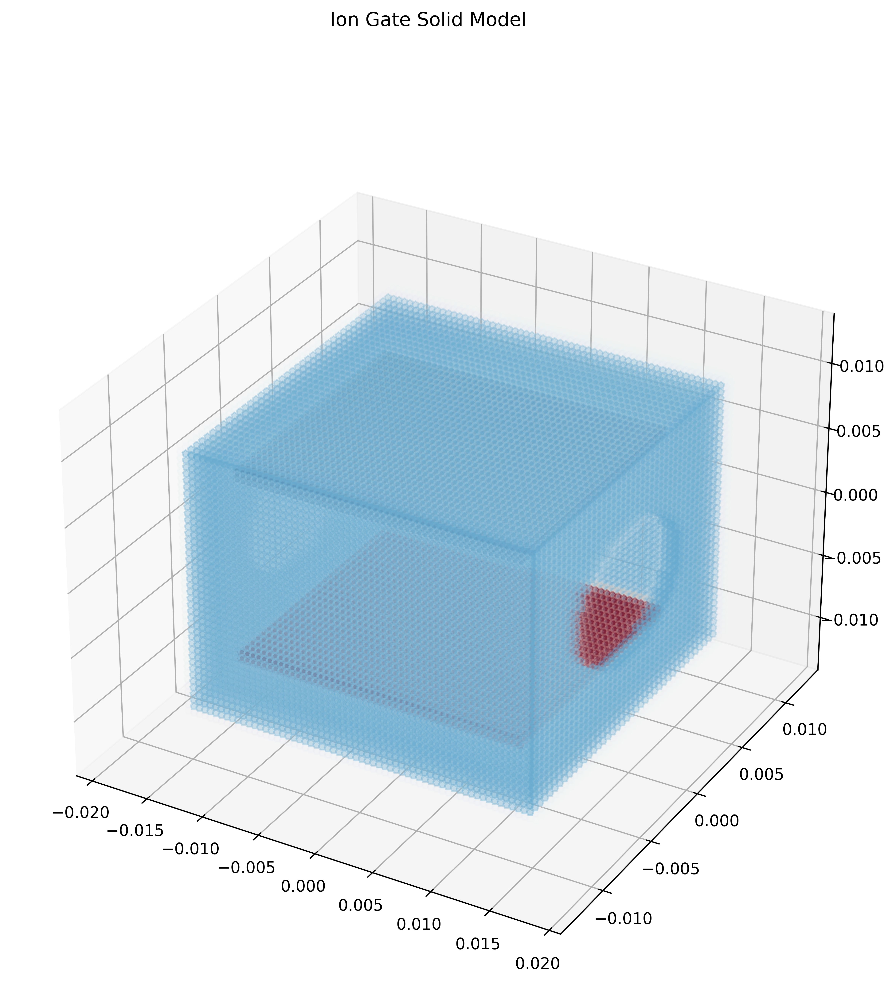

<Figure size 432x288 with 0 Axes>

In [4]:
def draw_gate_model():
    sim, enf = generate_dfgate(1, 0, -2)
    sim.compute(enf, convergence_limit=1e10, transient_ignore=1)

    plt.figure(figsize=(10, 10), dpi=libvis.DPI)
    plt.suptitle("Ion Gate Solid Model")
    ax = plt.axes(projection='3d')
    libvis.Visualizations.colormesh_3d(sim, graph_ax=ax, color_legend=False)
    plt.show()
    plt.savefig(OUT_D + "/gate_model_perspective.png", dpi=libvis.DPI)

draw_gate_model()

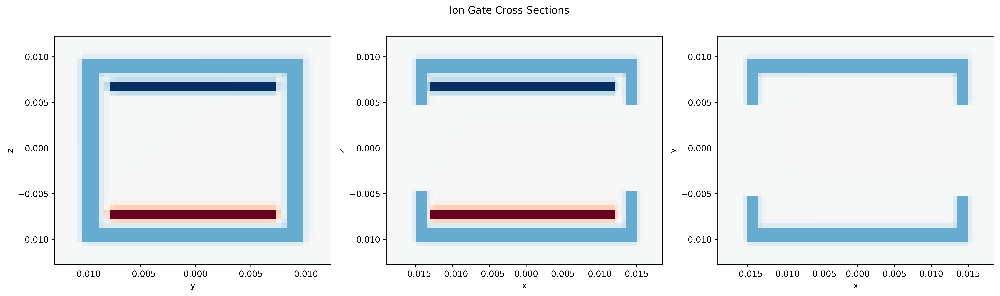

In [6]:
def draw_gate_xsections():
    sim, enf = generate_dfgate(1, 0, -2)
    sim.compute(enf, convergence_limit=1e10, transient_ignore=1)

    _, axs = plt.subplots(1, 3, figsize=(20, 5), dpi=libvis.DPI)
    plt.suptitle("Ion Gate Cross-Sections")
    labels = ["x", "y", "z"]
    for i, ax in enumerate(axs):
        sub_label = labels[:]
        sub_label.pop(i)
        ax.set_xlabel(sub_label[0])
        ax.set_ylabel(sub_label[1])

        sim2d = libem.EMSimulationSpace2D.from_3d(sim, axis=i, location=0)
        libvis.Visualizations.colormesh_2d(sim2d, color_norm=2, graph_ax=ax, color_legend=False)
    plt.savefig(OUT_D + "/gate_model_xsections.png", dpi=libvis.DPI)

draw_gate_xsections()

Display the voltage and field when the gate is on.

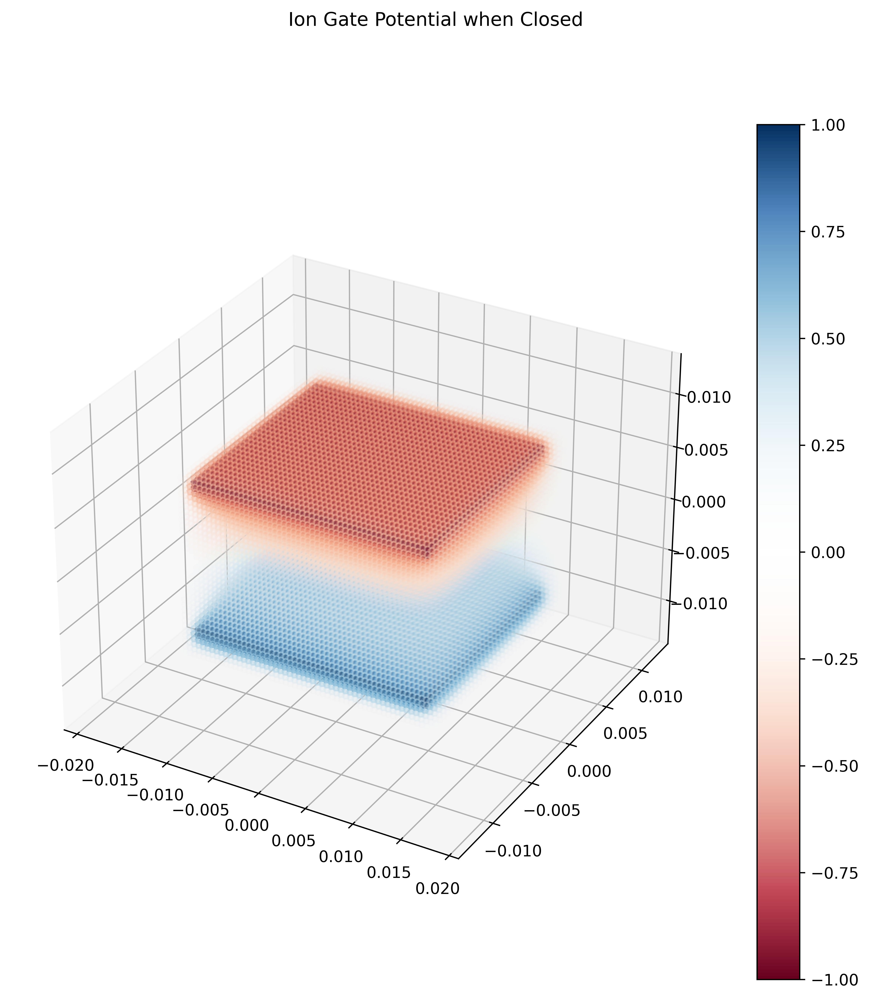

In [7]:
def draw_gate_closed():
    sim, enf = generate_dfgate(0, 0, 1)
    sim.compute(enf)

    plt.figure(figsize=(10, 10), dpi=libvis.DPI)
    plt.suptitle("Ion Gate Potential when Closed")
    ax = plt.axes(projection='3d')
    libvis.Visualizations.colormesh_3d(sim, graph_ax=ax)
    plt.savefig(OUT_D + "/gate_closed_potential.png", dpi=libvis.DPI)

draw_gate_closed()

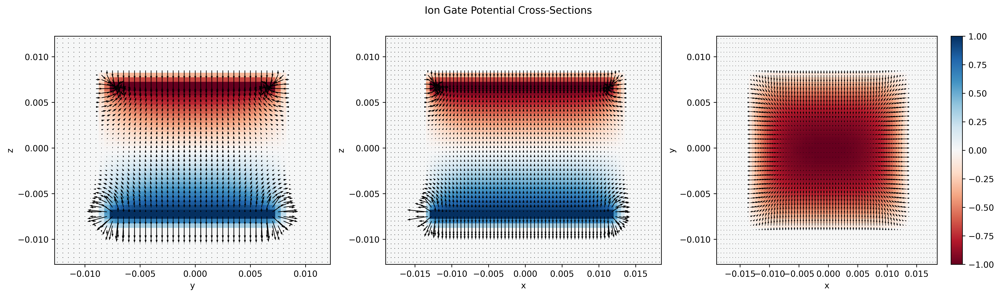

<Figure size 432x288 with 0 Axes>

In [10]:
def draw_gate_closed_xsections():
    sim, enf = generate_dfgate(0, 0, 1)
    sim.compute(enf)
    sim.get_efield()

    _, axs = plt.subplots(1, 3, figsize=(20, 5), dpi=libvis.DPI)
    plt.suptitle("Ion Gate Potential Cross-Sections")
    labels = ["x", "y", "z"]
    for i, ax in enumerate(axs):
        sub_label = labels[:]
        sub_label.pop(i)
        ax.set_xlabel(sub_label[0])
        ax.set_ylabel(sub_label[1])

        sim2d = libem.EMSimulationSpace2D.from_3d(sim, axis=i, location=0)
        libvis.Visualizations.colormesh_2d(sim2d, graph_ax=ax, color_legend=True if i == 0 else False)
        libvis.Visualizations.efield_2d(sim2d, graph_ax=ax)
    plt.savefig(OUT_D + "/gate_closed_potential_xsections.png", dpi=libvis.DPI)

draw_gate_closed_xsections()